# Paper: **LaMa: Resolution-robust Large Mask Inpainting with Fourier Convolutions**

[[Project page](https://saic-mdal.github.io/lama-project/)] [[GitHub](https://github.com/saic-mdal/lama)] [[arXiv](https://arxiv.org/abs/2109.07161)] [[Supplementary](https://ashukha.com/projects/lama_21/lama_supmat_2021.pdf)] [[BibTeX](https://senya-ashukha.github.io/projects/lama_21/paper.txt)]



# 1. Reproduction Part

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!python -V

Python 3.7.13


In [3]:
%%bash
MINICONDA_INSTALLER_SCRIPT=Miniconda3-4.5.4-Linux-x86_64.sh
MINICONDA_PREFIX=/usr/local
wget https://repo.continuum.io/miniconda/$MINICONDA_INSTALLER_SCRIPT
chmod +x $MINICONDA_INSTALLER_SCRIPT
./$MINICONDA_INSTALLER_SCRIPT -b -f -p $MINICONDA_PREFIX

conda install --channel defaults conda python=3.8 --yes
conda update --channel defaults --all --yes

PREFIX=/usr/local
installing: python-3.6.5-hc3d631a_2 ...
installing: ca-certificates-2018.03.07-0 ...
installing: conda-env-2.6.0-h36134e3_1 ...
installing: libgcc-ng-7.2.0-hdf63c60_3 ...
installing: libstdcxx-ng-7.2.0-hdf63c60_3 ...
installing: libffi-3.2.1-hd88cf55_4 ...
installing: ncurses-6.1-hf484d3e_0 ...
installing: openssl-1.0.2o-h20670df_0 ...
installing: tk-8.6.7-hc745277_3 ...
installing: xz-5.2.4-h14c3975_4 ...
installing: yaml-0.1.7-had09818_2 ...
installing: zlib-1.2.11-ha838bed_2 ...
installing: libedit-3.1.20170329-h6b74fdf_2 ...
installing: readline-7.0-ha6073c6_4 ...
installing: sqlite-3.23.1-he433501_0 ...
installing: asn1crypto-0.24.0-py36_0 ...
installing: certifi-2018.4.16-py36_0 ...
installing: chardet-3.0.4-py36h0f667ec_1 ...
installing: idna-2.6-py36h82fb2a8_1 ...
installing: pycosat-0.6.3-py36h0a5515d_0 ...
installing: pycparser-2.18-py36hf9f622e_1 ...
installing: pysocks-1.6.8-py36_0 ...
installing: ruamel_yaml-0.15.37-py36h14c3975_2 ...
installing: six-1.11

--2022-04-30 11:54:39--  https://repo.continuum.io/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.continuum.io (repo.continuum.io)... 104.18.200.79, 104.18.201.79, 2606:4700::6812:c94f, ...
Connecting to repo.continuum.io (repo.continuum.io)|104.18.200.79|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh [following]
--2022-04-30 11:54:39--  https://repo.anaconda.com/miniconda/Miniconda3-4.5.4-Linux-x86_64.sh
Resolving repo.anaconda.com (repo.anaconda.com)... 104.16.131.3, 104.16.130.3, 2606:4700::6810:8303, ...
Connecting to repo.anaconda.com (repo.anaconda.com)|104.16.131.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 58468498 (56M) [application/x-sh]
Saving to: ‘Miniconda3-4.5.4-Linux-x86_64.sh’

     0K .......... .......... .......... .......... ..........  0% 52.0M 1s
    50K .......... .......... .......... .......... ..........  0%

In [4]:
import sys
sys.path.append("/usr/local/lib/python3.8/site-packages")

In [5]:
# updata python 3.7 to 3.8
!cp -r /usr/local/lib/python3.7/dist-packages /usr/local/lib/python3.8/

In [6]:
!python3.8 -m pip install wget

  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=536db04ec0f55470d4768489dbf58b949afa2c2bc30e9adbc2f763163853b5f0
  Stored in directory: /root/.cache/pip/wheels/bd/a8/c3/3cf2c14a1837a4e04bd98631724e81f33f462d86a1d895fae0
Successfully built wget


In [7]:
!python3.8 -m pip install torchvision

     |████████████████████████████████| 21.0 MB 6.6 MB/s 
     |████████████████████████████████| 16.8 MB 35.5 MB/s 
     |████████████████████████████████| 4.3 MB 44.1 MB/s 
     |████████████████████████████████| 750.6 MB 18 kB/s 


In [8]:
!python -V

Python 3.8.13


In [9]:
print('\n> Cloning the repo')
!git clone https://github.com/saic-mdal/lama.git

print('\n> Install dependencies')
!python3.8 -m pip install -r lama/requirements.txt --quiet
!python3.8 -m pip install wget --quiet

print('\n> Changing the dir to:')
% cd /content/lama

print('\n> Download the model')
!curl -L $(yadisk-direct https://disk.yandex.ru/d/ouP6l8VJ0HpMZg) -o big-lama.zip
!unzip big-lama.zip

print('>fixing opencv')
!pip uninstall opencv-python-headless -y --quiet
!python3.8 -m pip install opencv-python-headless==4.1.2.30 --quiet


print('\n> Init mask-drawing code')
import base64, os
from IPython.display import HTML, Image
from google.colab.output import eval_js
from base64 import b64decode
import matplotlib.pyplot as plt
import numpy as np
import wget
from shutil import copyfile
import shutil



canvas_html = """
<style>
.button {
  background-color: #4CAF50;
  border: none;
  color: white;
  padding: 15px 32px;
  text-align: center;
  text-decoration: none;
  display: inline-block;
  font-size: 16px;
  margin: 4px 2px;
  cursor: pointer;
}
</style>
<canvas1 width=%d height=%d>
</canvas1>
<canvas width=%d height=%d>
</canvas>

<button class="button">Finish</button>
<script>
var canvas = document.querySelector('canvas')
var ctx = canvas.getContext('2d')

var canvas1 = document.querySelector('canvas1')
var ctx1 = canvas.getContext('2d')


ctx.strokeStyle = 'red';

var img = new Image();
img.src = "data:image/%s;charset=utf-8;base64,%s";
console.log(img)
img.onload = function() {
  ctx1.drawImage(img, 0, 0);
};
img.crossOrigin = 'Anonymous';

ctx.clearRect(0, 0, canvas.width, canvas.height);

ctx.lineWidth = %d
var button = document.querySelector('button')
var mouse = {x: 0, y: 0}

canvas.addEventListener('mousemove', function(e) {
  mouse.x = e.pageX - this.offsetLeft
  mouse.y = e.pageY - this.offsetTop
})
canvas.onmousedown = ()=>{
  ctx.beginPath()
  ctx.moveTo(mouse.x, mouse.y)
  canvas.addEventListener('mousemove', onPaint)
}
canvas.onmouseup = ()=>{
  canvas.removeEventListener('mousemove', onPaint)
}
var onPaint = ()=>{
  ctx.lineTo(mouse.x, mouse.y)
  ctx.stroke()
}

var data = new Promise(resolve=>{
  button.onclick = ()=>{
    resolve(canvas.toDataURL('image/png'))
  }
})
</script>
"""

def draw(imgm, filename='drawing.png', w=400, h=200, line_width=1):
  display(HTML(canvas_html % (w, h, w,h, filename.split('.')[-1], imgm, line_width)))
  data = eval_js("data")
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)


> Cloning the repo
Cloning into 'lama'...
remote: Enumerating objects: 309, done.
remote: Counting objects: 100% (70/70), done.
remote: Compressing objects: 100% (31/31), done.
remote: Total 309 (delta 49), reused 41 (delta 39), pack-reused 239
Receiving objects: 100% (309/309), 6.50 MiB | 13.29 MiB/s, done.
Resolving deltas: 100% (90/90), done.

> Install dependencies
     |████████████████████████████████| 701 kB 4.3 MB/s 
     |████████████████████████████████| 12.4 MB 27.0 MB/s 
     |████████████████████████████████| 24.9 MB 42.9 MB/s 
     |████████████████████████████████| 60.5 MB 61 kB/s 
     |████████████████████████████████| 497.6 MB 1.7 kB/s 
     |████████████████████████████████| 306 kB 57.8 MB/s 
     |████████████████████████████████| 11.3 MB 51.3 MB/s 
     |████████████████████████████████| 11.7 MB 42.0 MB/s 
     |████████████████████████████████| 72 kB 659 kB/s 
     |████████████████████████████████| 144 kB 52.1 MB/s 
     |████████████████████████████████| 841 kB

<center>
<h1 style="font-size:10vw"><b>Predefined photo</b>: uncomment any line
<br>
<b>Local file</b>: leave the <tt>fname = None</tt></h1>
</center>

In [10]:
# pytorch cuda 10.2
!conda install pytorch==1.8.0 torchvision==0.9.0 torchaudio==0.8.0 cudatoolkit=10.2 -c pytorch
# opencv
!pip install opencv-python
# ninja
!conda install -c conda-forge ninja

Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ 
The environment is inconsistent, please check the package plan carefully
The following packages are causing the inconsistency:

  - defaults/linux-64::asn1crypto==0.24.0=py36_0
  - defaults/linux-64::six==1.11.0=py36h372c433_1
  - defaults/linux-64::chardet==3.0.4=py36h0f667ec_1
| / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / failed with initial frozen solve. Retrying with flexible solve.
Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - failed with repodata from current_repodata.json, will retry with next repodata source.
Solving environment: - \ | / - \ | / - \ | / - \ | / - \ | /

In [ ]:
!mkdir -p ade20k/ade20k-resnet50dilated-ppm_deepsup/
!wget -P ade20k/ade20k-resnet50dilated-ppm_deepsup/ http://sceneparsing.csail.mit.edu/model/pytorch/ade20k-resnet50dilated-ppm_deepsup/encoder_epoch_20.pth

--2022-04-03 12:05:46--  http://sceneparsing.csail.mit.edu/model/pytorch/ade20k-resnet50dilated-ppm_deepsup/encoder_epoch_20.pth
Resolving sceneparsing.csail.mit.edu (sceneparsing.csail.mit.edu)... 128.30.195.26
Connecting to sceneparsing.csail.mit.edu (sceneparsing.csail.mit.edu)|128.30.195.26|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 95015426 (91M)
Saving to: ‘ade20k/ade20k-resnet50dilated-ppm_deepsup/encoder_epoch_20.pth’

encoder_epoch_20.pt 100%[===================>]  90.61M  40.4MB/s    in 2.2s    

2022-04-03 12:05:48 (40.4 MB/s) - ‘ade20k/ade20k-resnet50dilated-ppm_deepsup/encoder_epoch_20.pth’ saved [95015426/95015426]



In [ ]:
!pwd
!curl -L $(yadisk-direct https://disk.yandex.ru/d/EgqaSnLohjuzAg) -o lama-models.zip
!unzip lama-models.zip

/content/lama
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0
100 6257M    0 6257M    0     0   9.9M      0 --:--:--  0:10:27 --:--:--  9.7M
Archive:  lama-models.zip
  inflating: LaMa_models/big-lama-with-discr/config.yaml  
  inflating: LaMa_models/big-lama-with-discr/models/best.ckpt  
  inflating: LaMa_models/big-lama/config.yaml  
  inflating: LaMa_models/big-lama/models/best.ckpt  
  inflating: LaMa_models/lama-celeba-hq-pl-abl/lama-no-pl/config.yaml  
  inflating: LaMa_models/lama-celeba-hq-pl-abl/lama-no-pl/models/best.ckpt  
  inflating: LaMa_models/lama-celeba-hq/ lama-regular/config.yaml  
  inflating: LaMa_models/lama-celeba-hq/ lama-regular/models/best.ckpt  
  inflating: LaMa_models/lama-celeba-hq/lama-deep/config.yaml  
  inflating: LaMa_models/lama-celeba-hq/lama-deep/models/best.ckpt

In [ ]:
# if you want to train on the dataset whose size is smaller than 30000, you should adjust the shuffled.flist files
!rm /content/lama/fetch_data/train_shuffled.flist
!rm /content/lama/fetch_data/val_shuffled.flist
!cp /content/lama/replacement_files/train_shuffled.flist /content/lama/fetch_data/
!cp /content/lama/replacement_files/train_shuffled.flist /content/lama/fetch_data/

!rm /content/lama/fetch_data/celebahq_dataset_prepare.sh
!cp /content/lama/replacement_files/celebahq_dataset_prepare.sh /content/lama/fetch_data/


In [ ]:
!mkdir /content/lama/celeba-hq-dataset
!cp /content/drive/MyDrive/ColabNotebooks/data256x256.zip /content/lama/

mkdir: cannot create directory ‘/content/lama/celeba-hq-dataset’: File exists


In [ ]:
!bash fetch_data/celebahq_dataset_prepare.sh

mkdir: cannot create directory ‘celeba-hq-dataset’: File exists
Archive:  data256x256.zip
   creating: celeba-hq-dataset/data256x256/
  inflating: celeba-hq-dataset/data256x256/00001.jpg  
  inflating: celeba-hq-dataset/data256x256/00002.jpg  
  inflating: celeba-hq-dataset/data256x256/00003.jpg  
  inflating: celeba-hq-dataset/data256x256/00004.jpg  
  inflating: celeba-hq-dataset/data256x256/00005.jpg  
  inflating: celeba-hq-dataset/data256x256/00006.jpg  
  inflating: celeba-hq-dataset/data256x256/00007.jpg  
  inflating: celeba-hq-dataset/data256x256/00008.jpg  
  inflating: celeba-hq-dataset/data256x256/00009.jpg  
  inflating: celeba-hq-dataset/data256x256/00010.jpg  
  inflating: celeba-hq-dataset/data256x256/00011.jpg  
  inflating: celeba-hq-dataset/data256x256/00012.jpg  
  inflating: celeba-hq-dataset/data256x256/00013.jpg  
  inflating: celeba-hq-dataset/data256x256/00014.jpg  
  inflating: celeba-hq-dataset/data256x256/00015.jpg  
  inflating: celeba-hq-dataset/data256x25

In [ ]:
!bash fetch_data/celebahq_gen_masks.sh

In [ ]:
!python3 bin/train.py -cn lama-fourier-celeba data.batch_size=10

/usr/local/lib/python3.8/site-packages/hydra/core/default_element.py:122: UserWarning: In 'hydra/overrides': Usage of deprecated keyword in package header '# @package _group_'.
See https://hydra.cc/docs/next/upgrades/1.0_to_1.1/changes_to_package_header for more information
  warnings.warn(
/usr/local/lib/python3.8/site-packages/hydra/core/default_element.py:122: UserWarning: In 'trainer/any_gpu_large_ssim_ddp_final_celeba': Usage of deprecated keyword in package header '# @package _group_'.
See https://hydra.cc/docs/next/upgrades/1.0_to_1.1/changes_to_package_header for more information
  warnings.warn(
/usr/local/lib/python3.8/site-packages/hydra/core/default_element.py:122: UserWarning: In 'evaluator/default_inpainted': Usage of deprecated keyword in package header '# @package _group_'.
See https://hydra.cc/docs/next/upgrades/1.0_to_1.1/changes_to_package_header for more information
  warnings.warn(
/usr/local/lib/python3.8/site-packages/hydra/core/default_element.py:122: UserWarnin

# 2. Extension Part

In [11]:
!git clone https://github.com/facebookresearch/detectron2.git
!python -m pip install -e detectron2

Cloning into 'detectron2'...
remote: Enumerating objects: 14027, done.
remote: Total 14027 (delta 0), reused 0 (delta 0), pack-reused 14027
Receiving objects: 100% (14027/14027), 5.76 MiB | 10.05 MiB/s, done.
Resolving deltas: 100% (10139/10139), done.
Obtaining file:///content/lama/detectron2
     |████████████████████████████████| 106 kB 4.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 50 kB 5.2 MB/s 
     |████████████████████████████████| 130 kB 24.8 MB/s 
     |████████████████████████████████| 764 kB 50.5 MB/s 
     |████████████████████████████████| 96 kB 5.1 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220414-py3-none-any.whl size=61211 sha256=0b71050da78c8d81e00b8f102e74df648b6ae065447e666d01b4f6980e75dc15
  Stored in directory: /root/.cache/pip/wheels/3c/f1/3a/d775ab1ab50edd8ddf8a14992295a81195e0542027f8df3f3c
  Created wheel for pyco

## Remove the specified category(eg. Person)
- Use Mask RCNN model with a dilated transformation to generate masks which can remove the specified category(eg.person) and then use Lama for inpainting.
- We provide several hyperparameters to help generate a better mask. 
  - category: specify the category we want to remove. (eg. person)
  - detect_model: the detection method which will be used to identify the object location. Possible values: segmentation or object_detect
  - detect_threthold: the detect_threthold in the Mask RCNN model.

In [17]:
#fname = 'http://images.cocodataset.org/val2017/000000439715.jpg'
#fname = None
fname = 'https://ic.pics.livejournal.com/mostovoy/28566193/1224276/1224276_original.jpg' # <-in the example
#fname = 'https://raw.githubusercontent.com/senya-ashukha/senya-ashukha.github.io/master/images/1010286.jpeg'
# fname = 'https://raw.githubusercontent.com/senya-ashukha/senya-ashukha.github.io/master/images/1010287.jpeg'
#fname = "https://raw.githubusercontent.com/senya-ashukha/senya-ashukha.github.io/master/images/alex.jpg"

Will use ./data_for_prediction/1224276_original.jpg for inpainting
Run inpainting
[2022-04-30 12:30:11,153][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-30 12:30:11,154][iopath.common.file_io][INFO] - Downloading https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-30 12:30:11,154][iopath.common.download][INFO] - Downloading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
model_final_f10217.pkl: 178MB [00:10, 17.3MB/s]               
[2022-04-30 12:30:21,451][iopath.common.download][INFO] - Successfully downloaded /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl. 177841981 bytes.
[2022-04-30 12:30:21,451

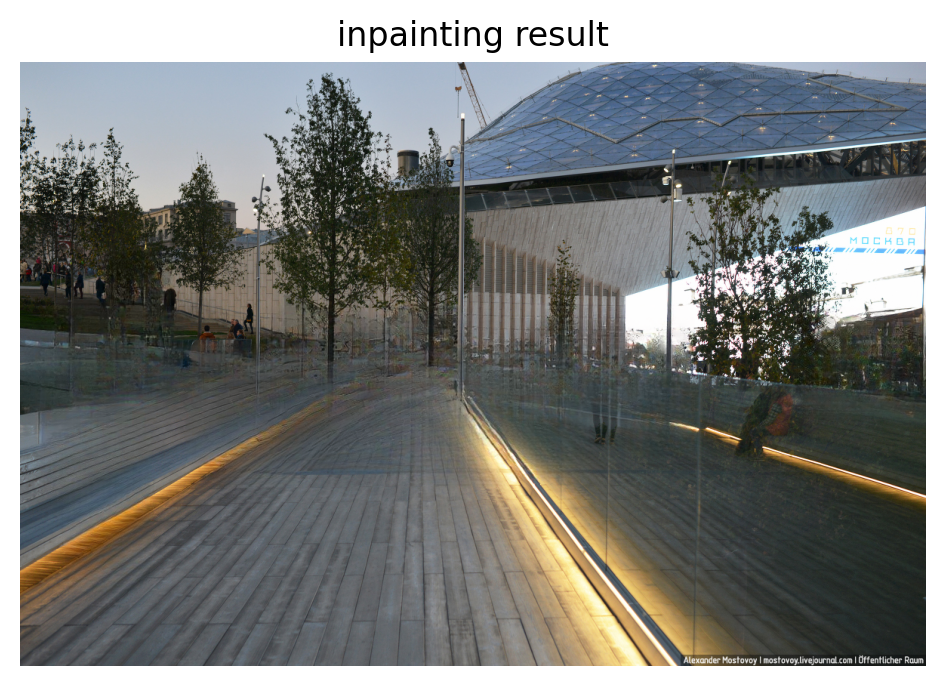

In [18]:
#@title Draw a Mask, Press Finish, Wait for Inpainting

if fname is None:
  from google.colab import files
  files = files.upload()
  fname = list(files.keys())[0]
else:
  fname = wget.download(fname)

shutil.rmtree('./data_for_prediction', ignore_errors=True)
! mkdir data_for_prediction

copyfile(fname, f'./data_for_prediction/{fname}')
os.remove(fname)
fname = f'./data_for_prediction/{fname}'

image64 = base64.b64encode(open(fname, 'rb').read())
image64 = image64.decode('utf-8')

print(f'Will use {fname} for inpainting')

img = np.array(plt.imread(f'{fname}')[:,:,:3])
plt.imshow(img)
plt.axis('off')
plt.title('img')

print('Run inpainting')


if '.jpeg' in fname:
  !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=person detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output dataset.img_suffix=.jpeg
elif '.jpg' in fname:
  !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=person detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output  dataset.img_suffix=.jpg
elif '.png' in fname:
  !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=person detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output  dataset.img_suffix=.png
else:
  print(f'Error: unknown suffix .{fname.split(".")[-1]} use [.png, .jpeg, .jpg]')

print("finish running")
plt.rcParams['figure.dpi'] = 200
plt.imshow(plt.imread(f"/content/output/{fname.split('.')[1].split('/')[2]}_mask.png"))
_=plt.axis('off')
_=plt.title('inpainting result')
plt.show()

## Run the detection+inpainting model for more data
- You can automatically remove the specified category for many images.
- You can specify multiple categories which tend to appear together to make the inpainted images more natural. 

In [19]:
# data_for_prediction: images you want to process
!unzip /content/lama/data_for_prediction.zip -d /content/lama/

Run inpainting
[2022-04-08 14:31:54,047][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:31:54,047][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:31:54,116][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
person
dog
person
person
person
chair
chair
person
person
person
person
person
person
person
person
car
car
car
car
car
person
car
traffic light
truck
car
traffic light
traffic light
car
person
person
person
boat
person
person
person
person
person
person
person
person
truck
truck
truck
car

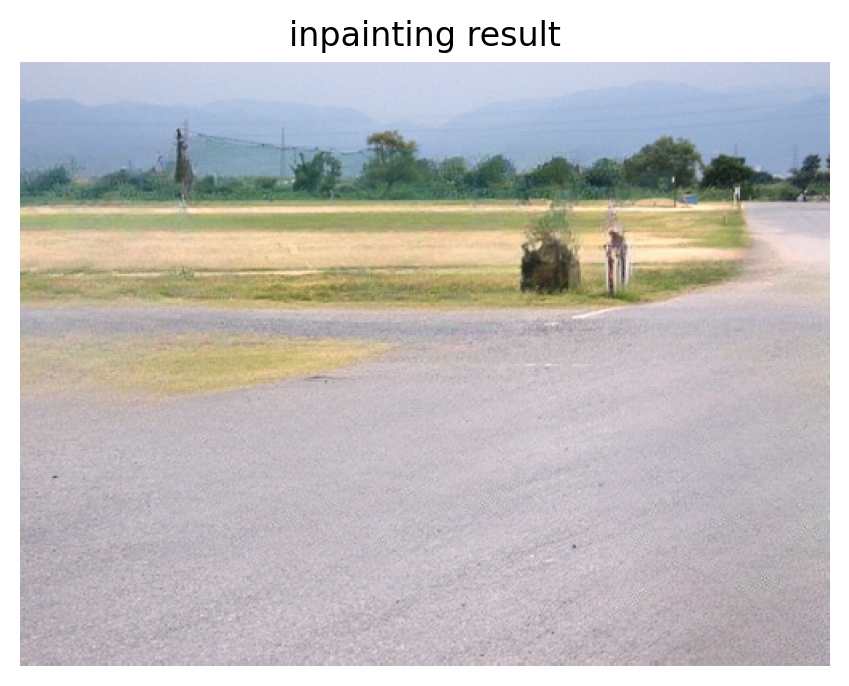

[2022-04-08 14:32:10,193][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:10,193][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:10,271][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


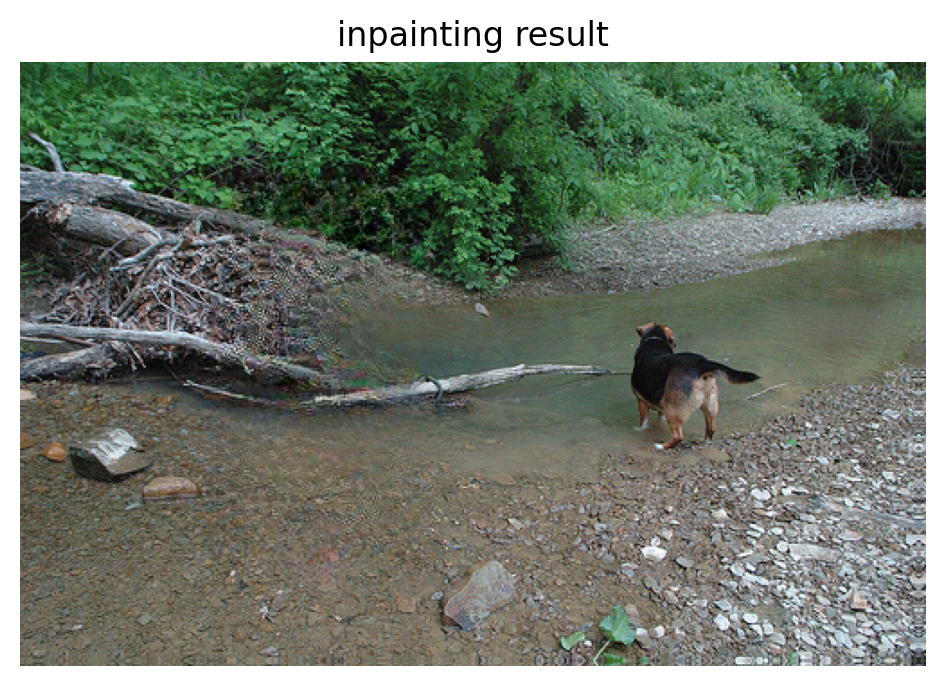

[2022-04-08 14:32:17,278][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:17,279][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:17,355][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


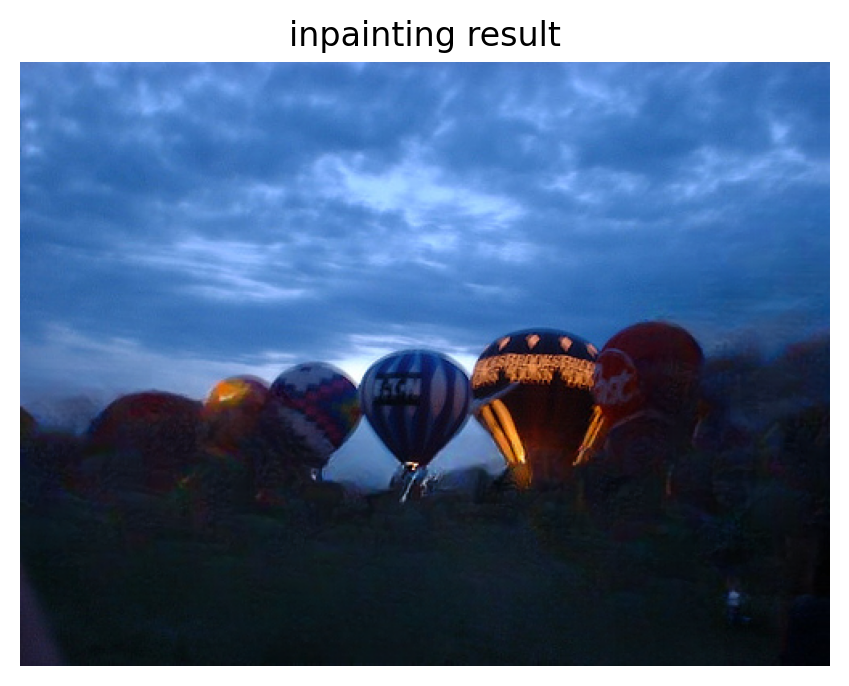

[2022-04-08 14:32:24,323][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:24,324][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:24,398][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


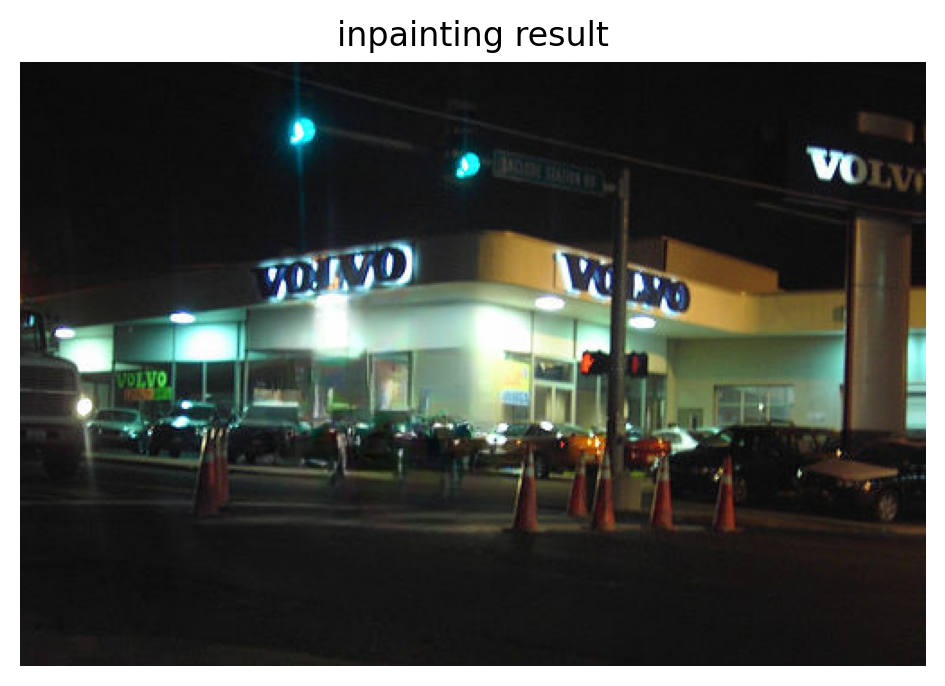

[2022-04-08 14:32:31,379][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:31,379][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:31,454][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


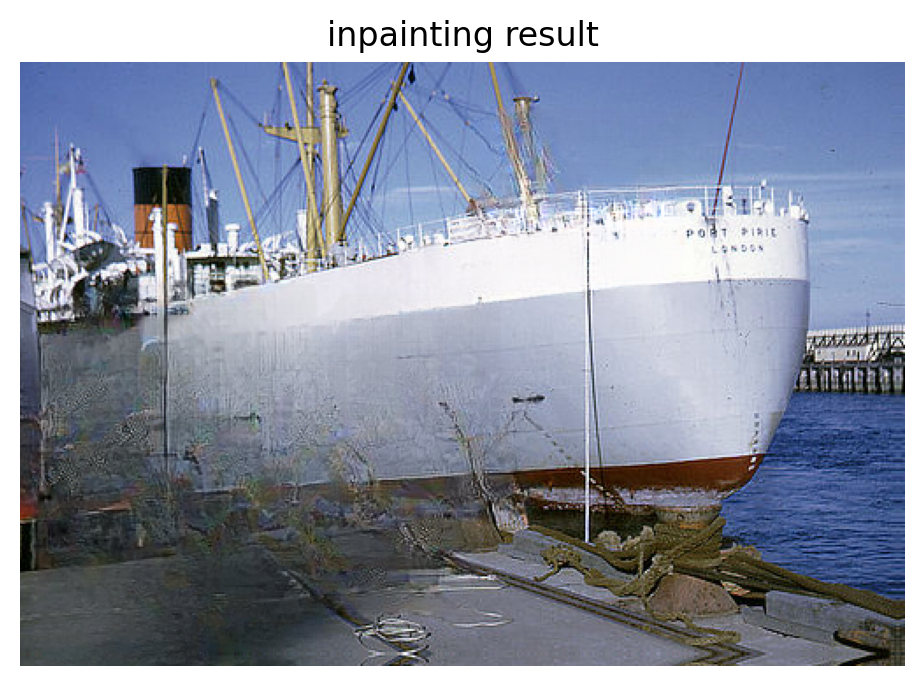

[2022-04-08 14:32:38,957][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:38,958][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:39,108][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


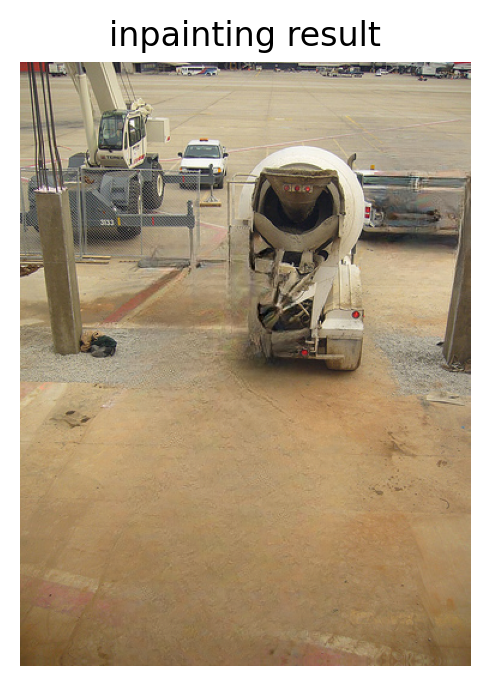

[2022-04-08 14:32:46,245][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:46,245][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:46,308][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


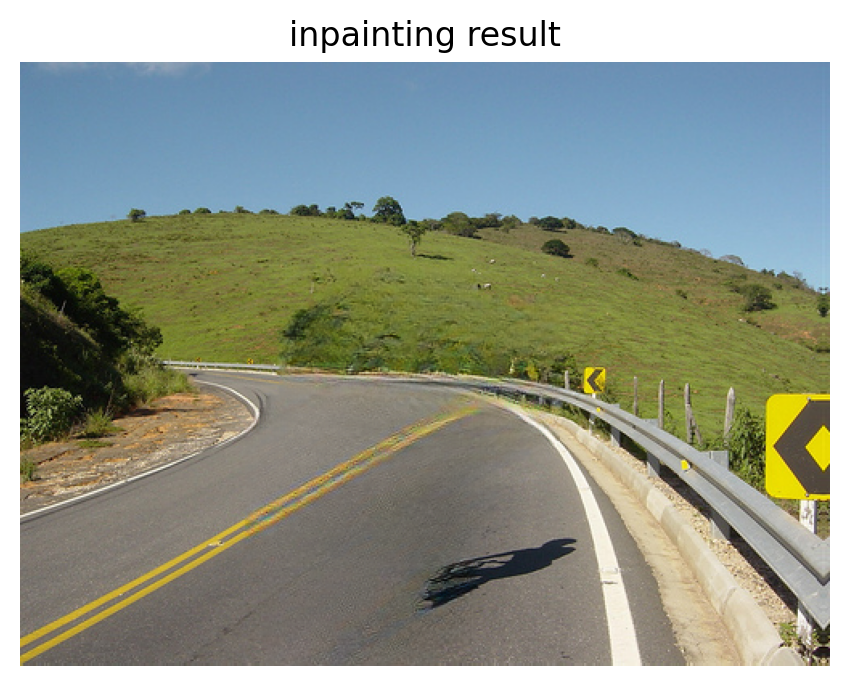

[2022-04-08 14:32:53,444][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:32:53,445][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:32:53,518][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


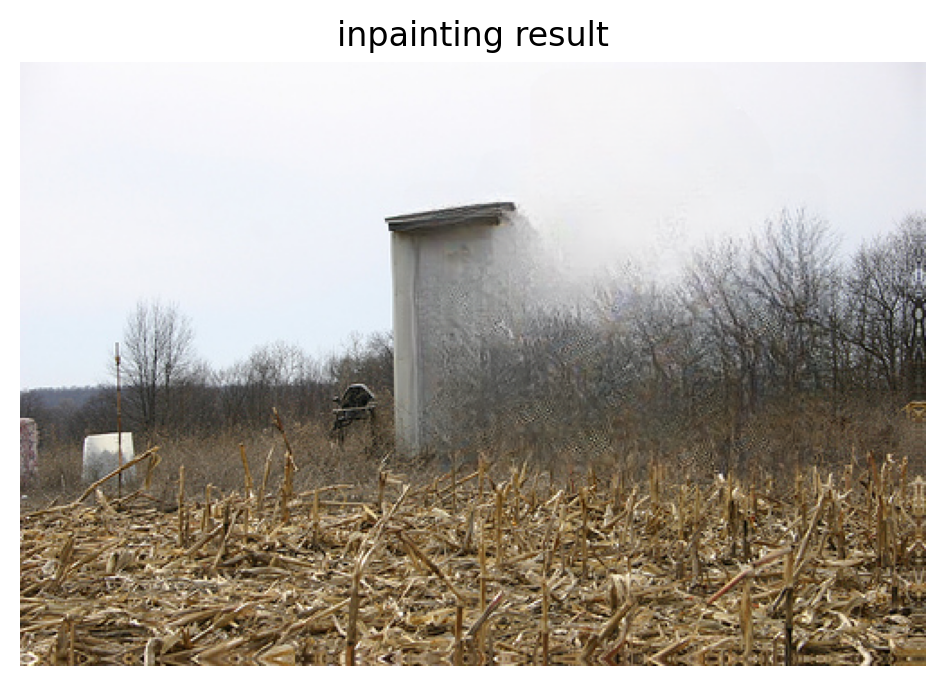

[2022-04-08 14:33:00,798][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:00,798][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:00,878][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


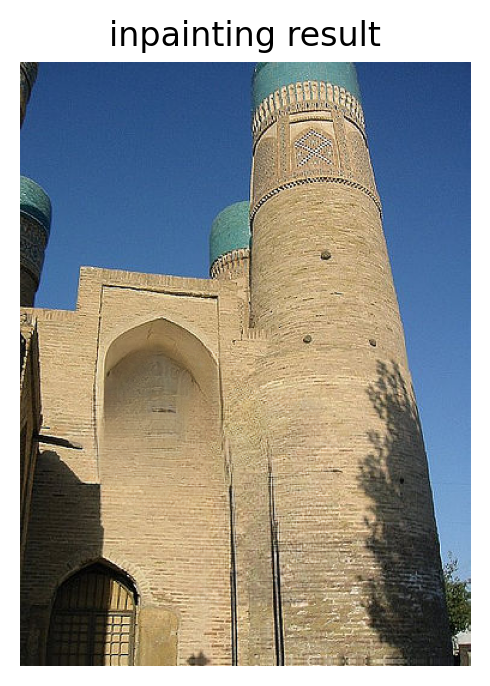

[2022-04-08 14:33:07,766][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:07,767][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:07,840][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


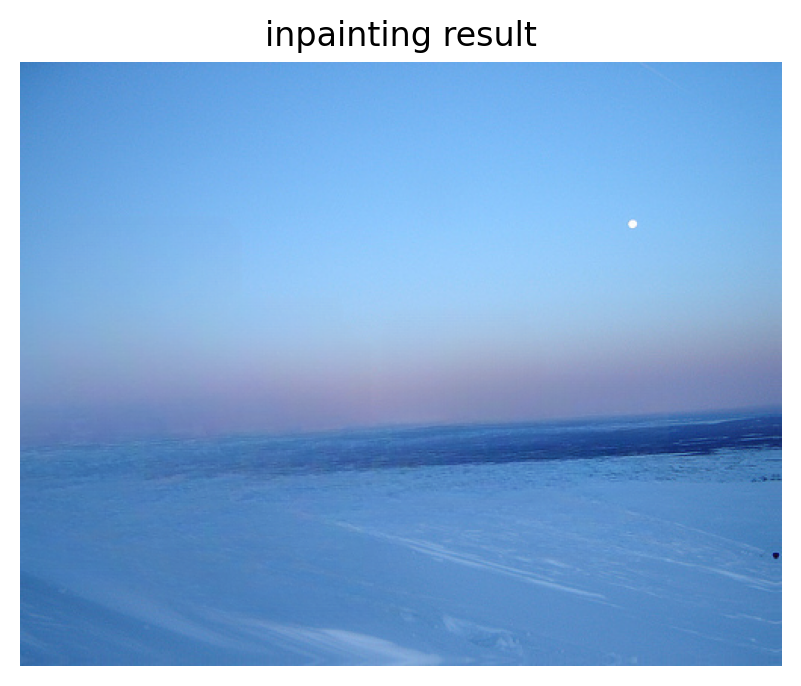

[2022-04-08 14:33:14,806][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:14,807][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:14,881][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


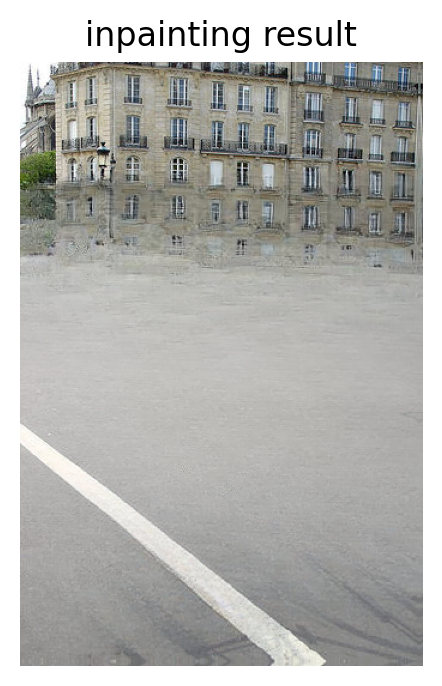

[2022-04-08 14:33:21,827][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:21,828][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:21,905][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


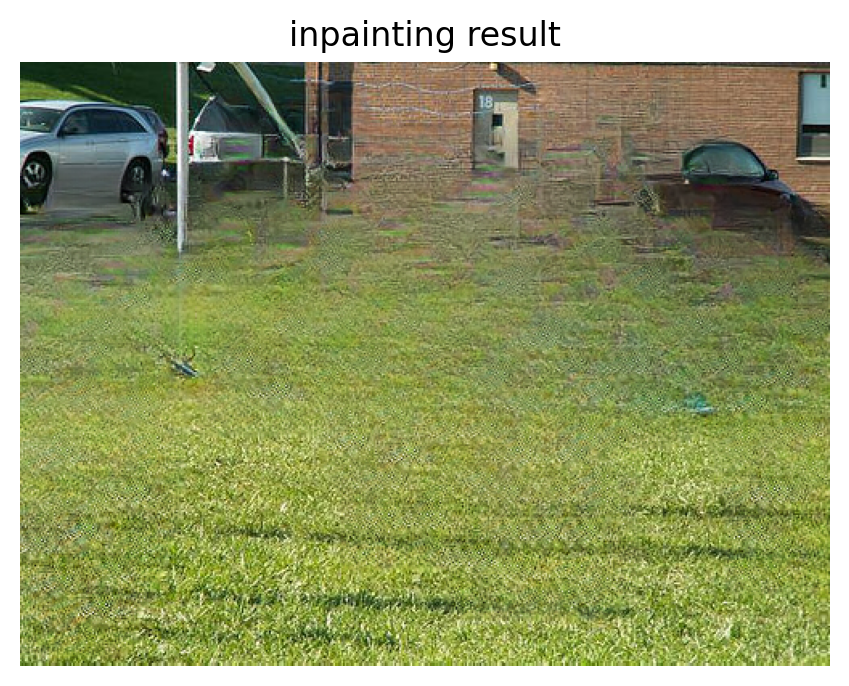

[2022-04-08 14:33:28,982][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:28,982][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:29,045][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


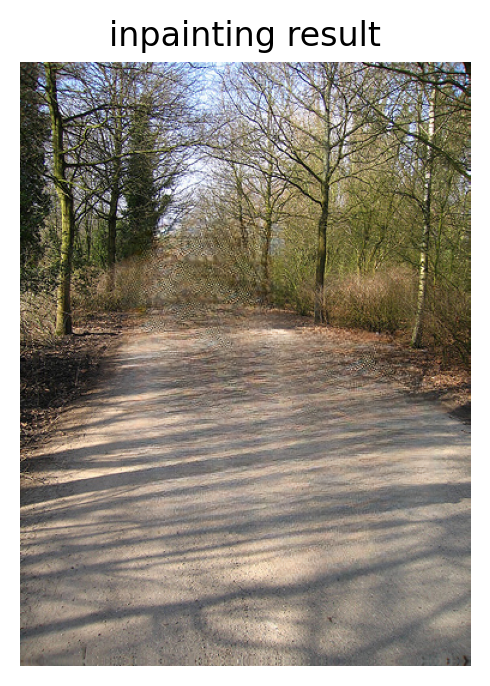

[2022-04-08 14:33:35,920][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:35,921][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:35,995][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


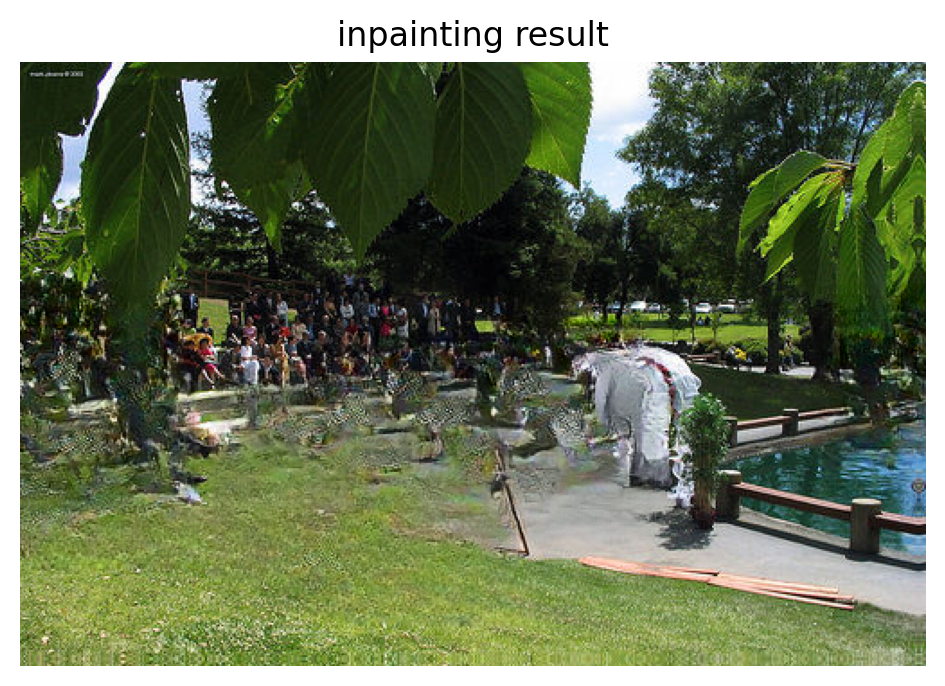

[2022-04-08 14:33:43,274][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:43,275][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:43,351][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


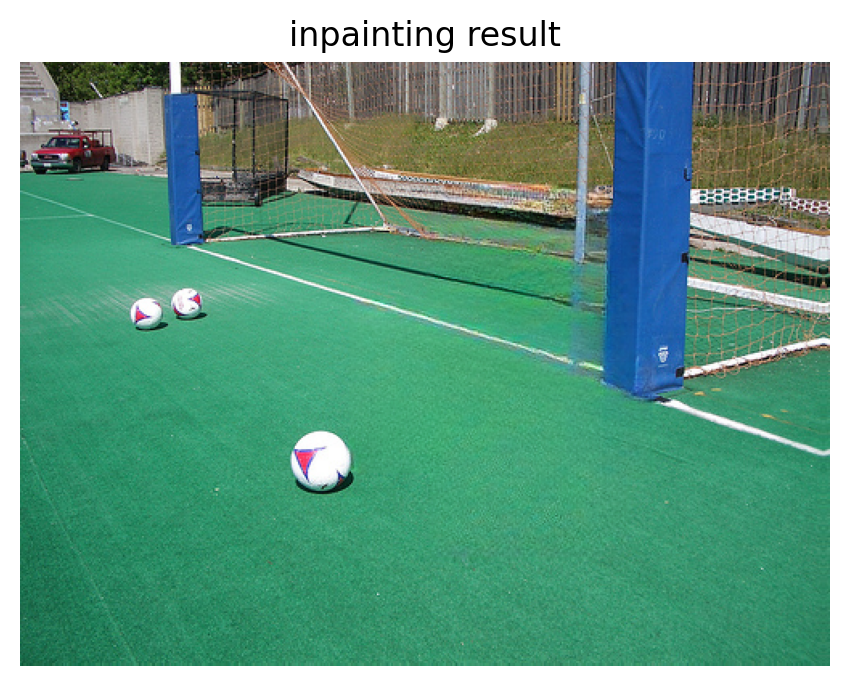

[2022-04-08 14:33:50,702][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:50,702][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:50,778][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


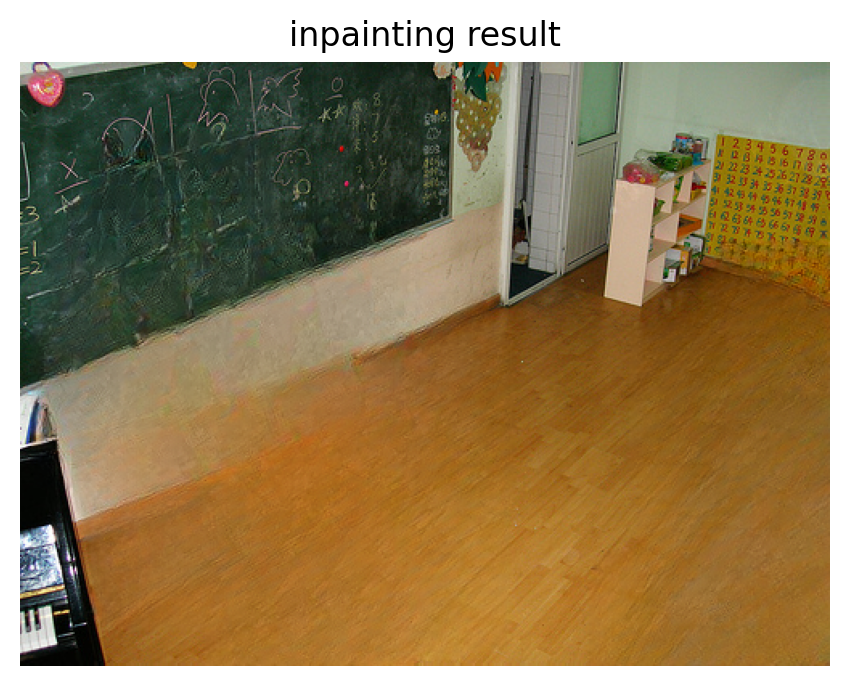

[2022-04-08 14:33:58,189][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:33:58,189][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:33:58,265][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


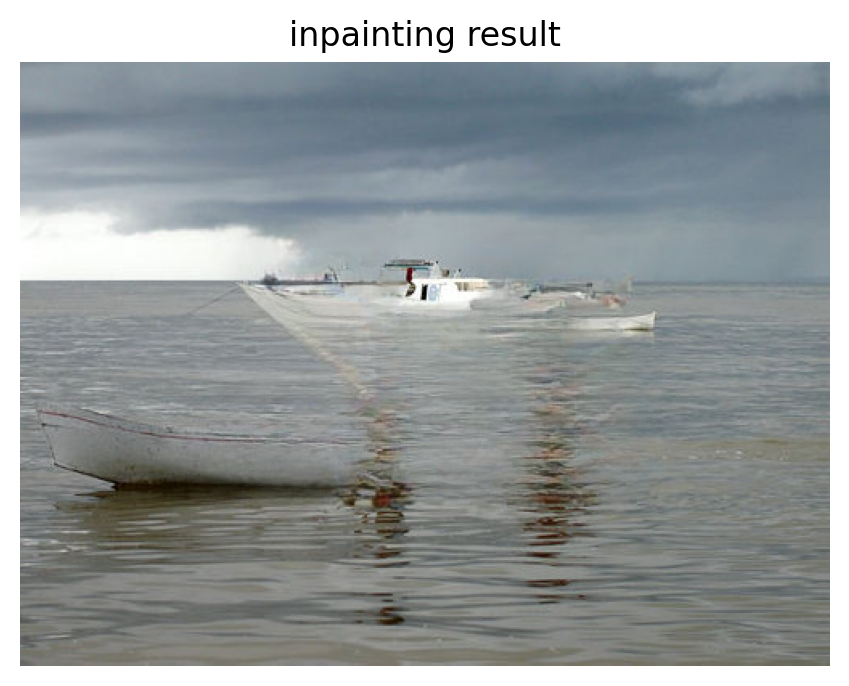

[2022-04-08 14:34:05,571][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:05,572][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:05,646][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


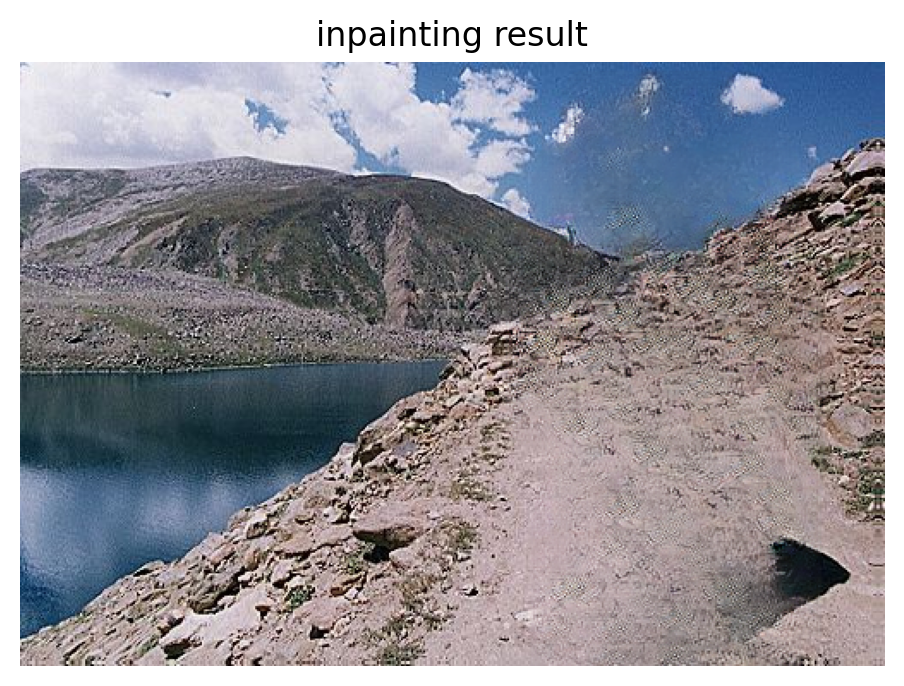

[2022-04-08 14:34:13,199][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:13,199][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:13,273][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


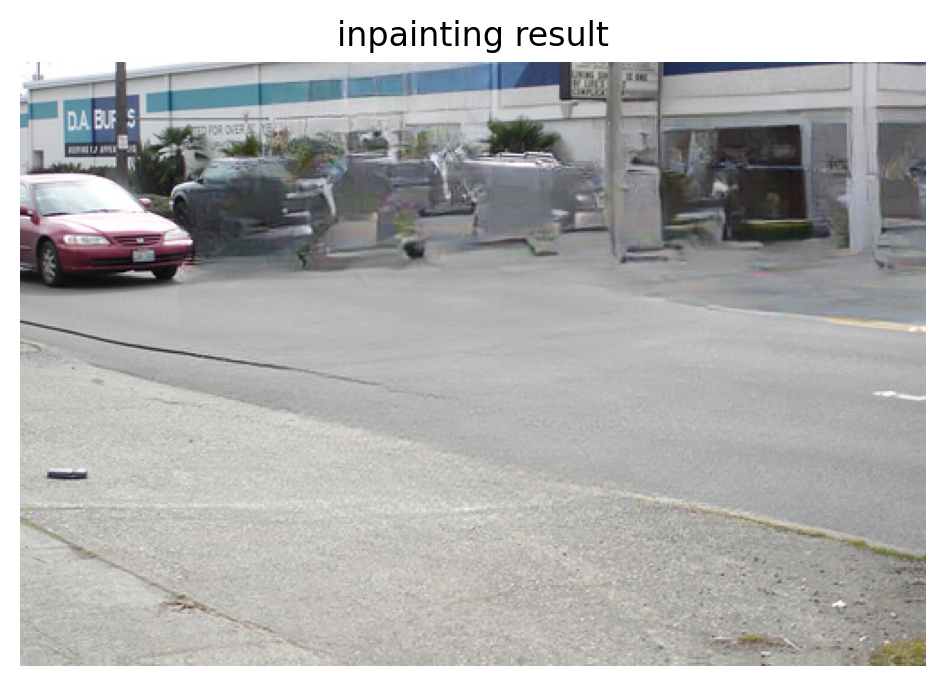

[2022-04-08 14:34:20,703][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:20,704][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:20,765][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


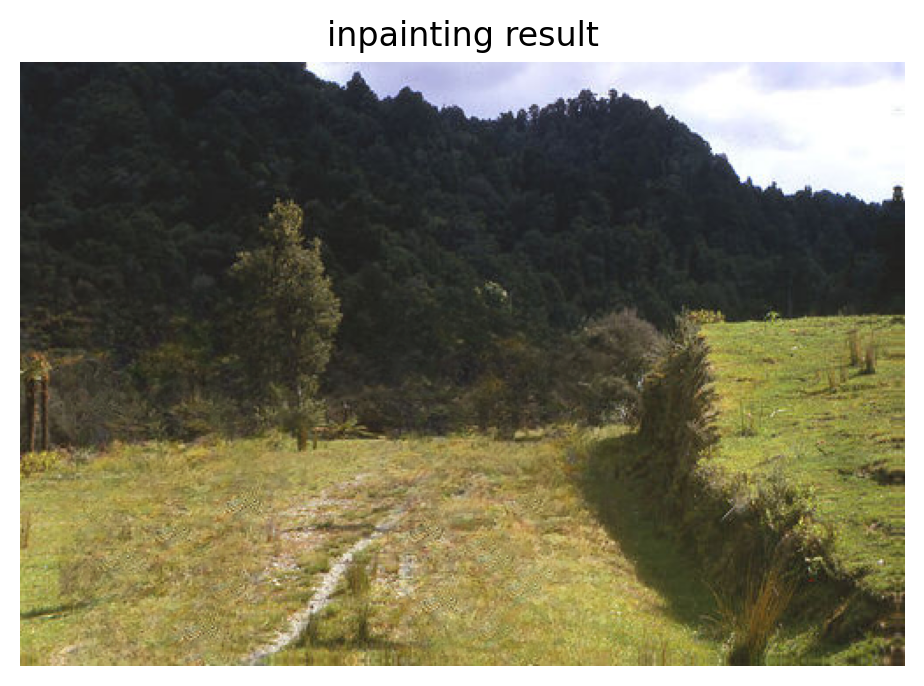

[2022-04-08 14:34:28,215][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:28,215][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:28,295][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


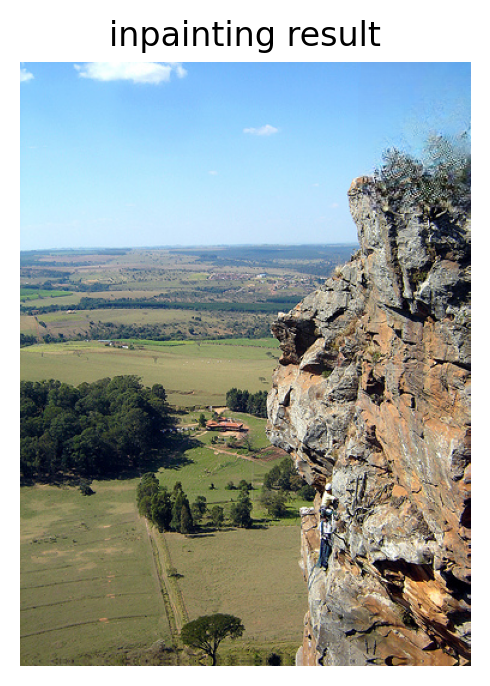

[2022-04-08 14:34:35,562][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:35,563][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:35,639][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


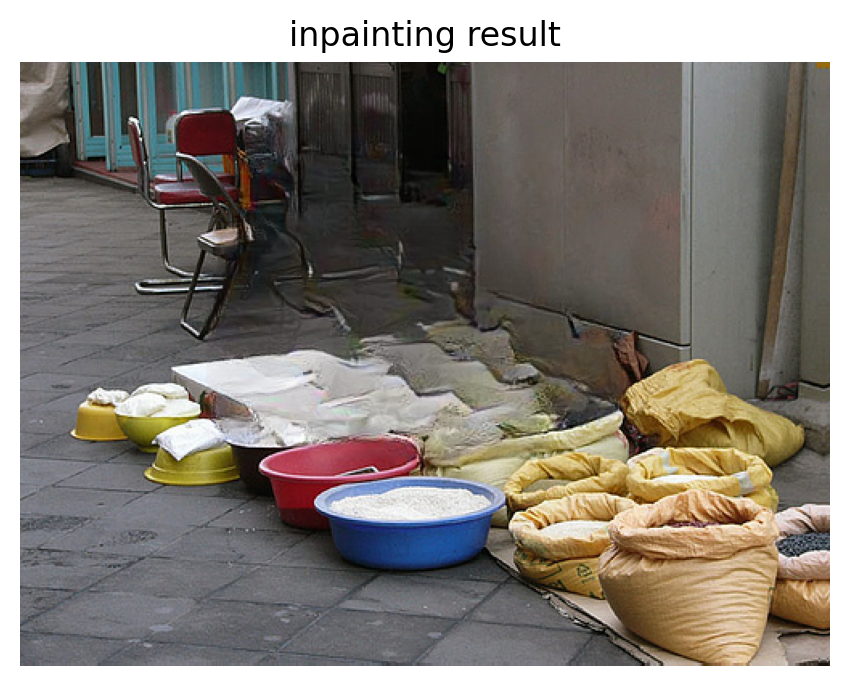

[2022-04-08 14:34:43,062][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:43,063][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:43,140][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


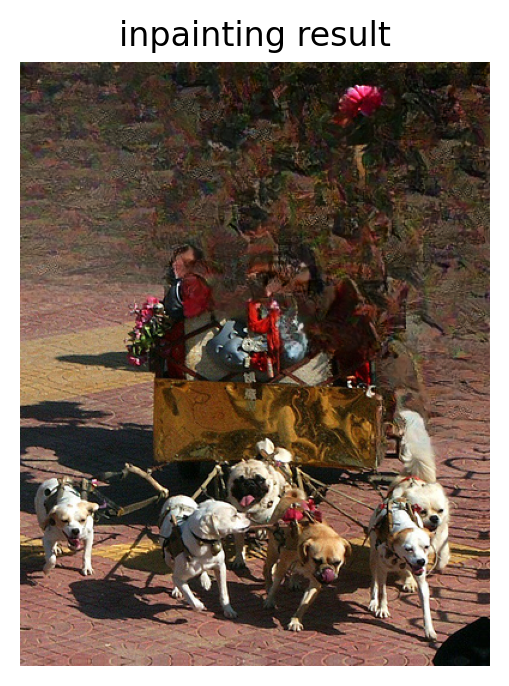

[2022-04-08 14:34:50,303][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:50,304][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:50,378][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


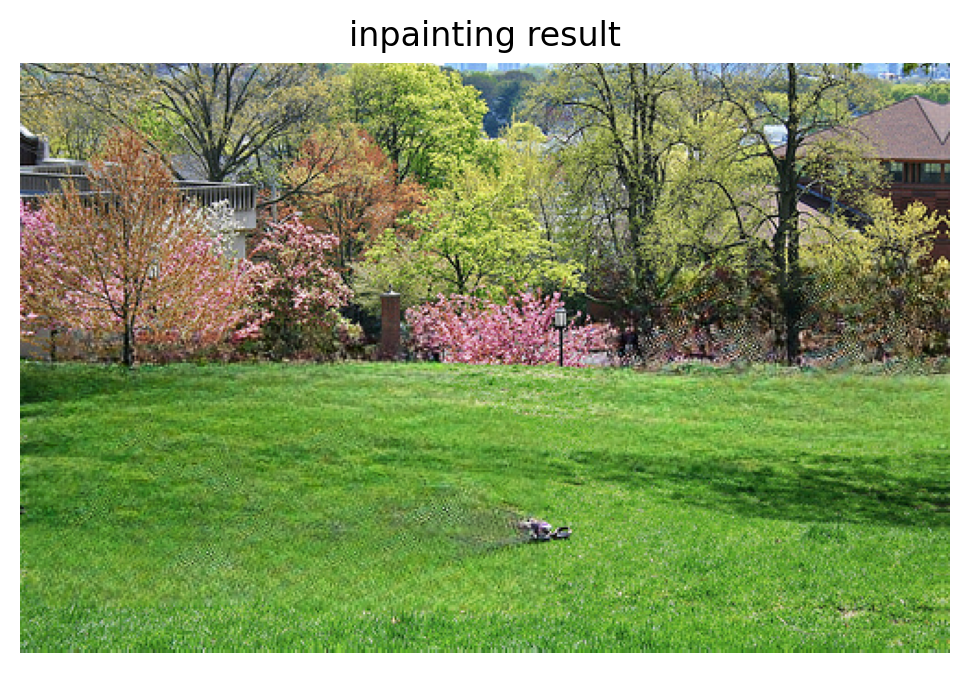

[2022-04-08 14:34:57,944][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:34:57,945][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:34:58,020][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


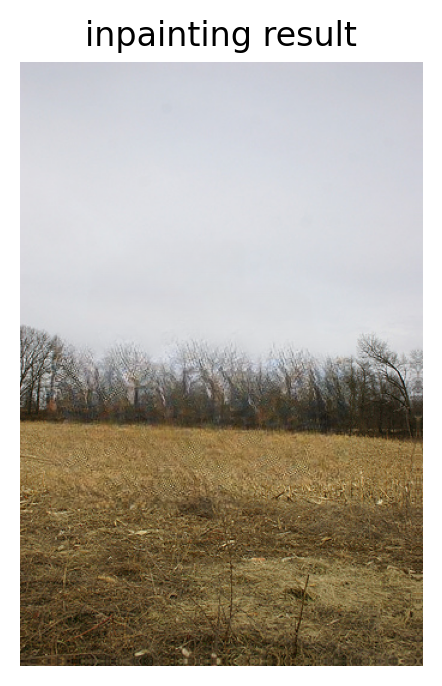

[2022-04-08 14:35:05,329][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:05,329][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:05,403][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


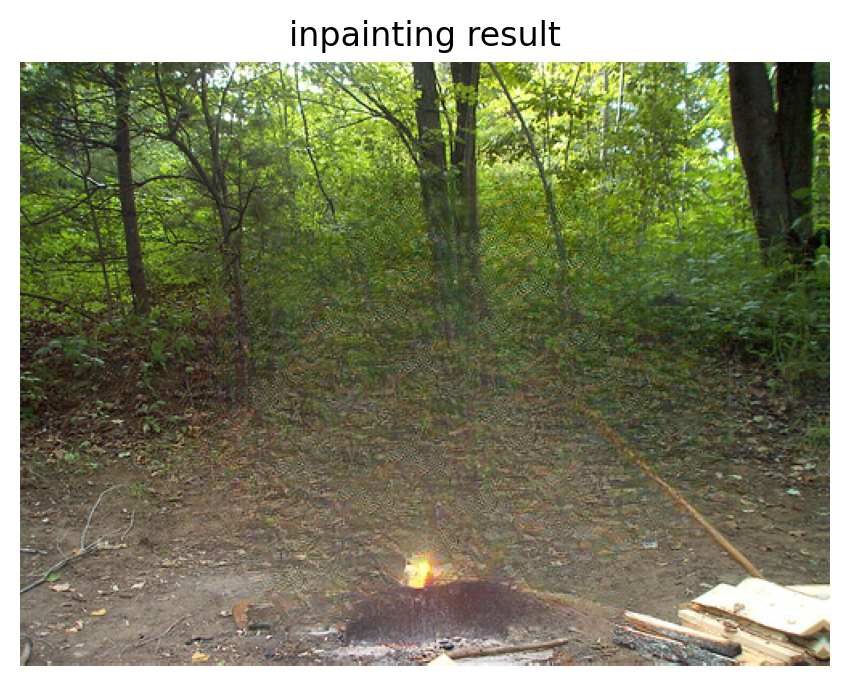

[2022-04-08 14:35:12,767][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:12,768][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:12,841][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


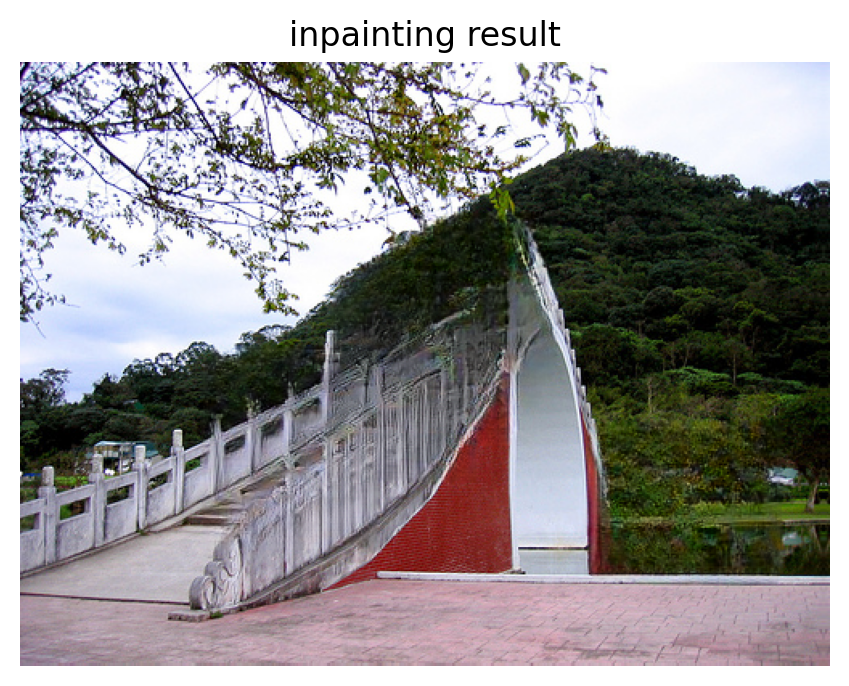

[2022-04-08 14:35:20,413][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:20,414][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:20,489][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


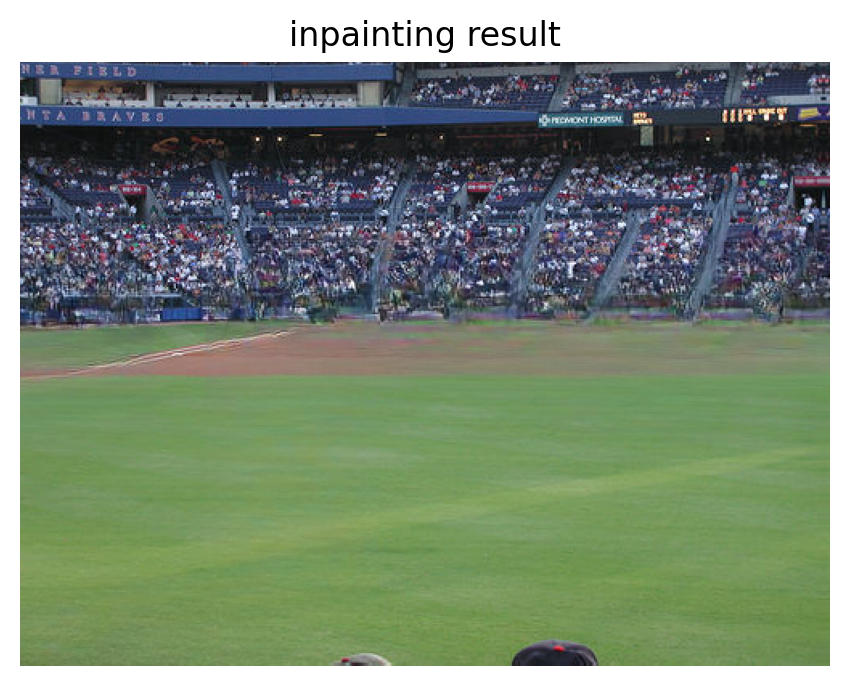

[2022-04-08 14:35:28,034][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:28,035][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:28,113][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


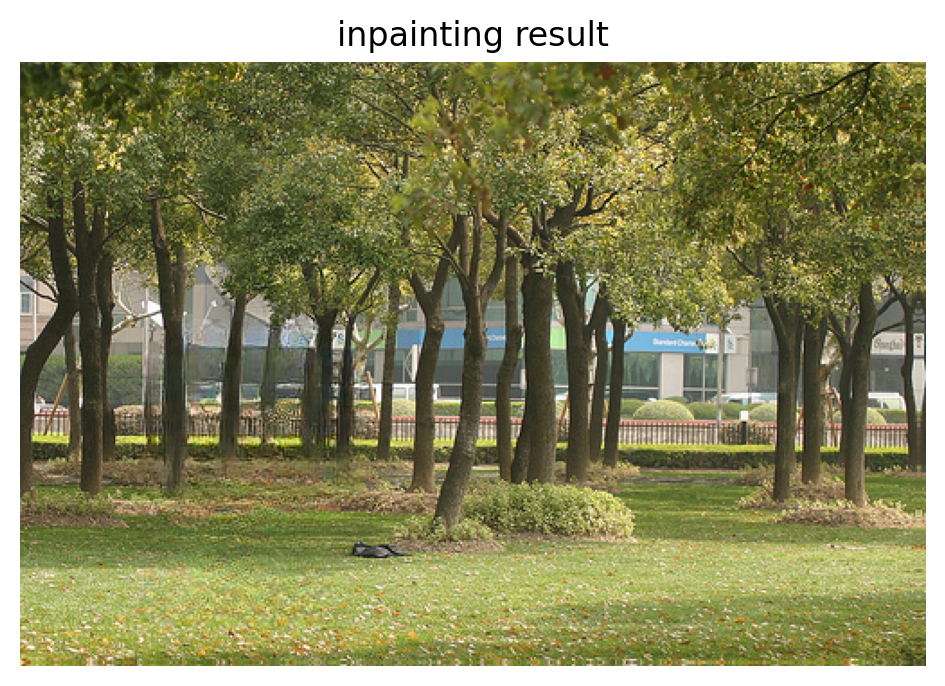

[2022-04-08 14:35:35,792][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:35,793][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:35,867][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


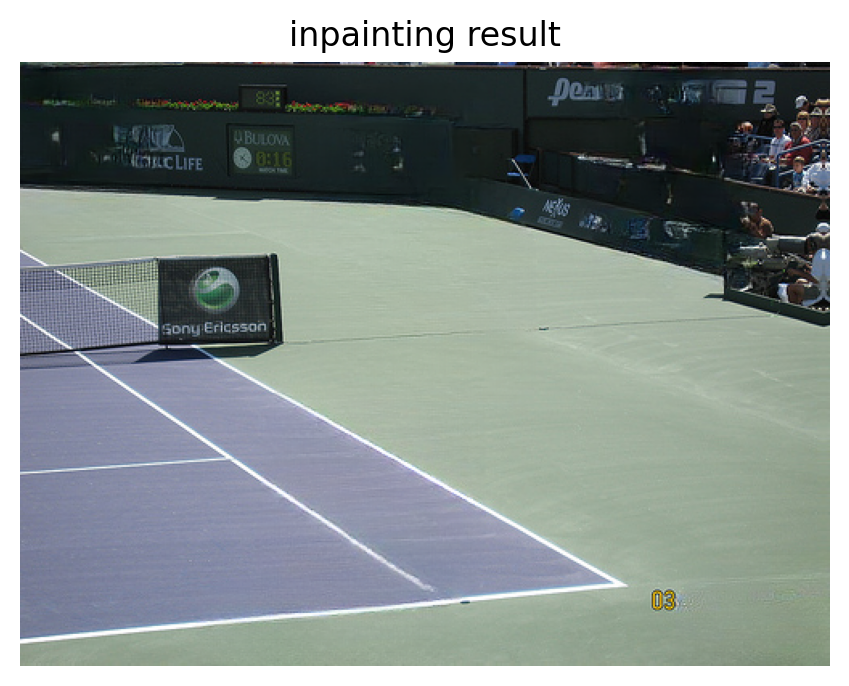

[2022-04-08 14:35:43,443][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:43,443][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:43,516][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


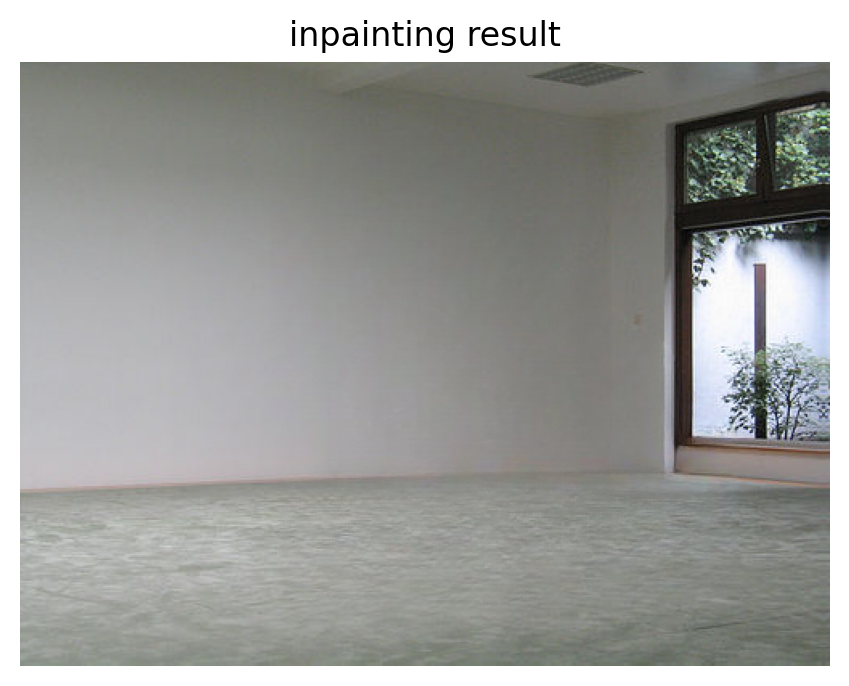

[2022-04-08 14:35:51,032][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:51,033][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:51,108][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


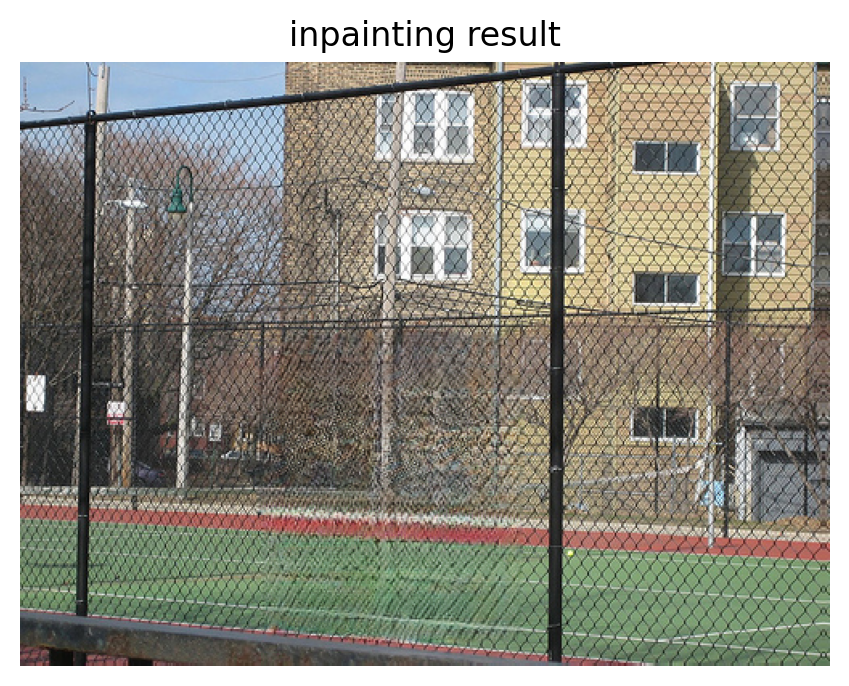

[2022-04-08 14:35:58,932][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:35:58,933][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:35:59,008][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


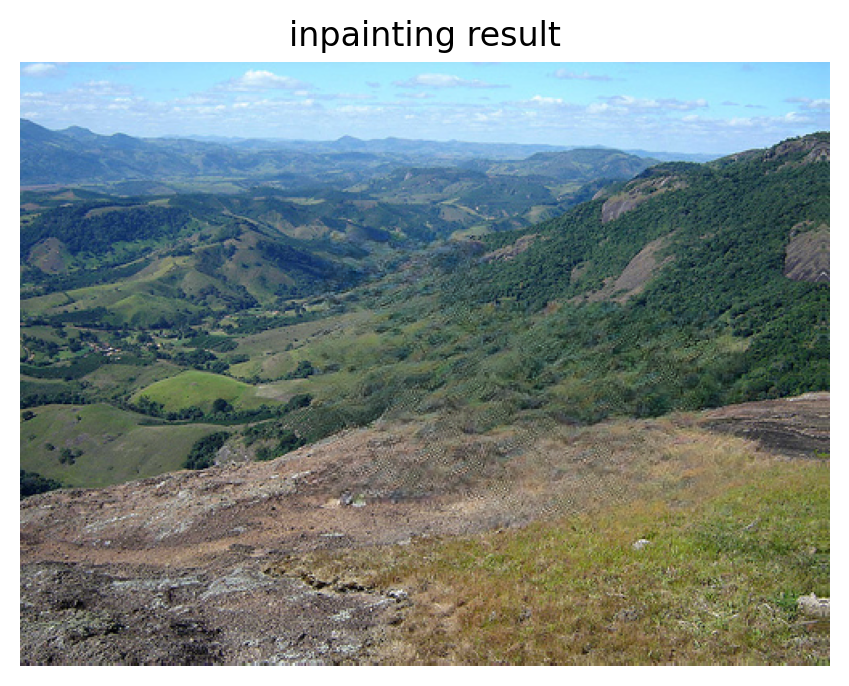

[2022-04-08 14:36:06,757][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:36:06,758][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:36:06,835][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


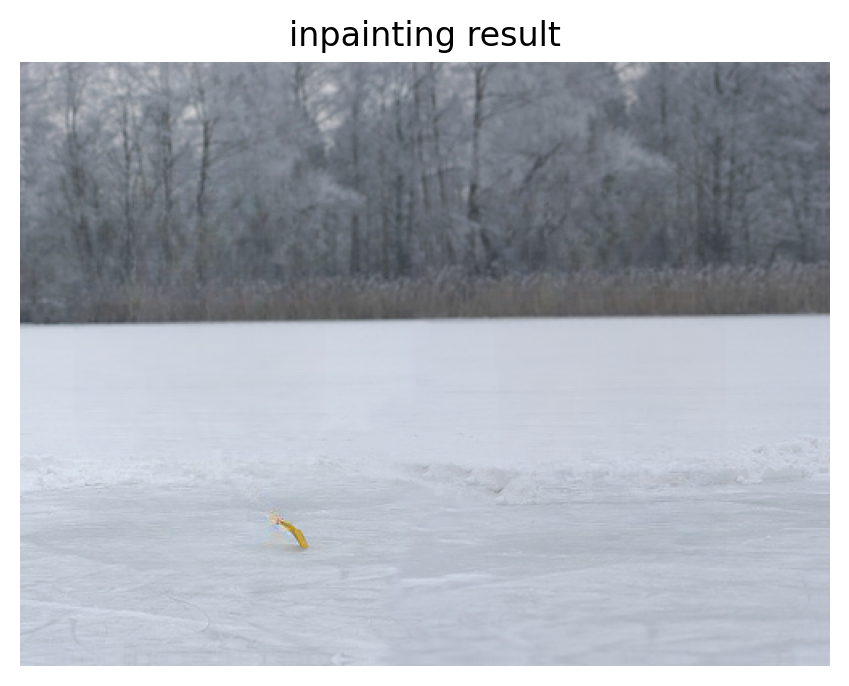

[2022-04-08 14:36:14,557][fvcore.common.checkpoint][INFO] - [Checkpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
[2022-04-08 14:36:14,558][iopath.common.file_io][INFO] - URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl cached in /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl
[2022-04-08 14:36:14,632][fvcore.common.checkpoint][INFO] - Reading a file from 'Detectron2 Model Zoo'
person
person
person
person
person
bicycle
motorcycle
car
person
Can not detect:  ['person', 'bicycle', 'motorcycle']
finish running


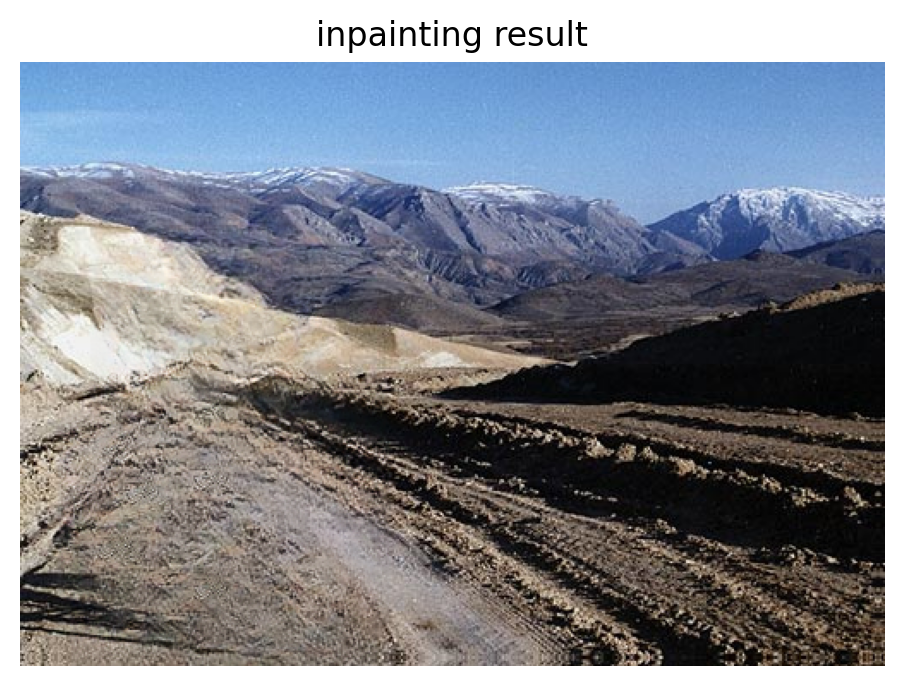

In [ ]:
print('Run inpainting')

for fname in os.listdir('./data_for_prediction/'):
  fname = f'./data_for_prediction/{fname}'
  if '.jpeg' in fname:
    !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=[person,bicycle,motorcycle] detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output dataset.img_suffix=.jpeg
  elif '.jpg' in fname:
    !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=[person,bicycle,motorcycle] detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output  dataset.img_suffix=.jpg
  elif '.png' in fname:
    !PYTHONPATH=. TORCH_HOME=$(pwd) python3 bin/detection.py model.path=/content/lama/big-lama category=[person,bicycle,motorcycle] detect_model=segmentation detect_threthold=0.7 indir=$(pwd)/data_for_prediction outdir=/content/output  dataset.img_suffix=.png
  else:
    print(f'Error: unknown suffix .{fname.split(".")[-1]} use [.png, .jpeg, .jpg]')

  print("finish running")
  plt.rcParams['figure.dpi'] = 200
  plt.imshow(plt.imread(f"/content/output/{fname.split('.')[1].split('/')[2]}_mask.png"))
  _=plt.axis('off')
  _=plt.title('inpainting result')
  plt.show()

In [20]:
# !cp -r /content/output /content/drive/MyDrive

In [ ]:
# input_dir = '/content/output256'

# file_list = []
# for root, dirs, files in os.walk(input_dir, topdown=False):
#     for name in files:
#         # file_list.append(name)
#         file_list.append(os.path.join(root, name))

In [ ]:
# # # resize data to shape (256, 256)
# out_shape = (256, 256)
# out_dir = '/content/output256new'

# for i, file in enumerate(file_list):
#     img = cv.imread(file)
#     img_new = cv.resize(img, out_shape)
#     cv.imwrite(os.path.join(out_dir, file[19:]), img_new)
    
#     if i % 1000 == 0:
#         print(i)

0


In [22]:
# # metrics calculation:
# !python3 bin/evaluate_predicts.py \
# $(pwd)/configs/eval2_gpu.yaml \
# /content/lama/data256x256new \
# /content/output256new \
# $(pwd)/inference/detection_metrics.csv